<a href="https://colab.research.google.com/github/kwongyunghwan/2020-2-AI/blob/master/mask.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!curl -L "https://public.roboflow.com/ds/CWN6gdHpMm?key=6nPaJ54SC9" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

In [ ]:
%cd /content
!git clone https://github.com/ultralytics/yolov5.git

In [ ]:
%cd /content/yolov5/
!pip install -r requirements.txt

In [ ]:
%cat /content/data.yaml

In [ ]:
%cd /
from glob import glob

img_list = glob('/content/train/images/*.jpg')

print(len(img_list))

In [ ]:
from sklearn.model_selection import train_test_split

train_img_list, val_img_list = train_test_split(img_list, test_size=0.2, random_state=2000)

print(len(train_img_list), len(val_img_list))

In [8]:
with open('/content/train.txt', 'w') as f:
  f.write('\n'.join(train_img_list) + '\n')

with open('/content/val.txt', 'w') as f:
  f.write('\n'.join(val_img_list) + '\n')

In [ ]:
import yaml

with open('/content/data.yaml', 'r') as f:
  data = yaml.load(f)

print(data)

data['train'] = '/content/train.txt'
data['val'] = '/content/val.txt'

with open('/content/data.yaml', 'w') as f:
  yaml.dump(data, f)

print(data)


In [ ]:
%cd /content/yolov5/

!python train.py --img 416 --batch 16 --epochs 100 --data /content/data.yaml --cfg ./models/yolov5s.yaml --weights yolov5s.pt --name gun_yolov5s_results

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs/

In [ ]:
!python detect.py --source ./mask1.jpg --weights ./runs/train/gun_yolov5s_results/weights/best.pt

In [ ]:
!python detect.py --weights ./runs/train/gun_yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source /content/dataset/mask1

In [ ]:
!python detect.py --weights ./runs/train/gun_yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source /content/dataset/mask_animation

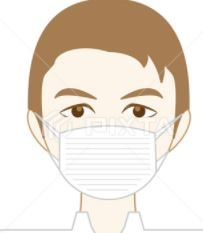

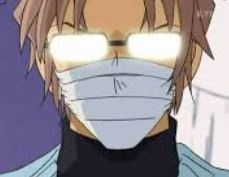

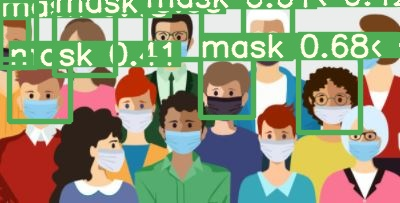

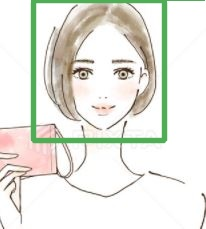

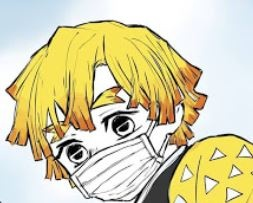

...

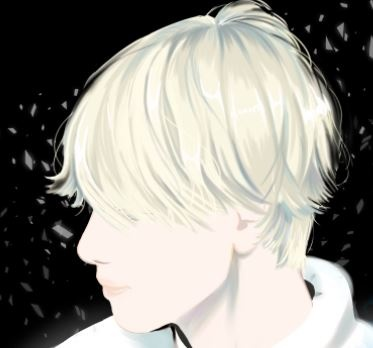

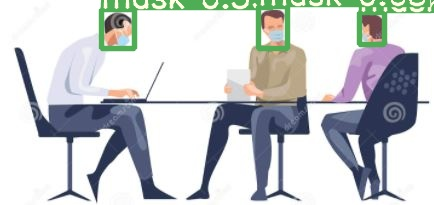

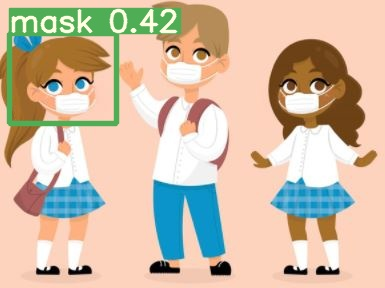

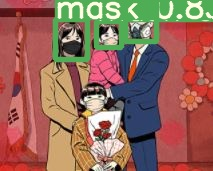

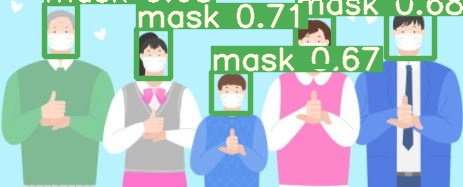

In [ ]:
#캐릭터
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp14/*.JPG'):
  display(Image(filename=imageName))
  print('\n')

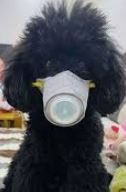

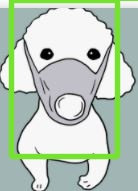

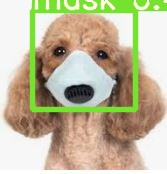

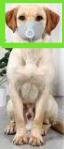

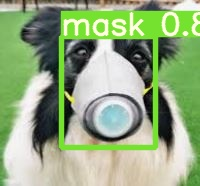

...

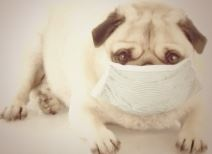

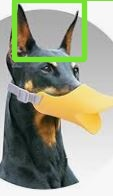

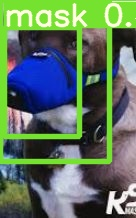

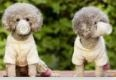

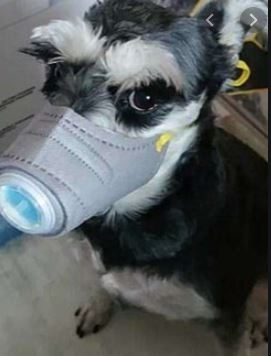

In [ ]:
#동물
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp13/*.JPG'):
  display(Image(filename=imageName))
  print('\n')

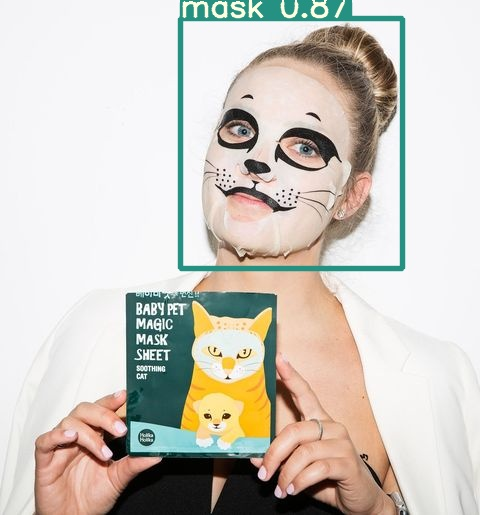

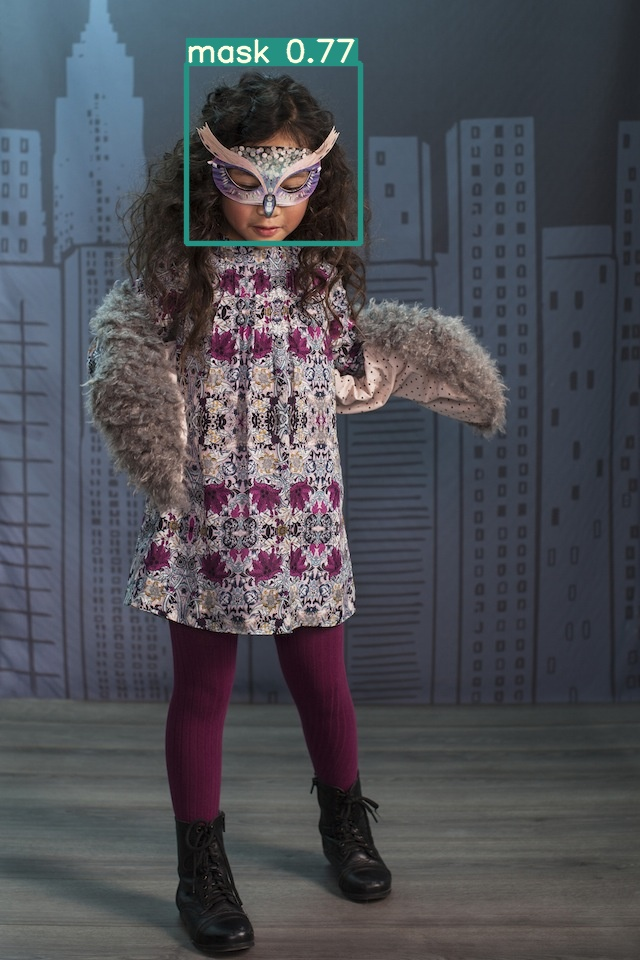

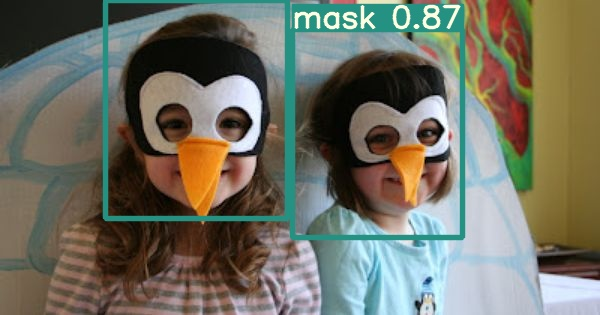

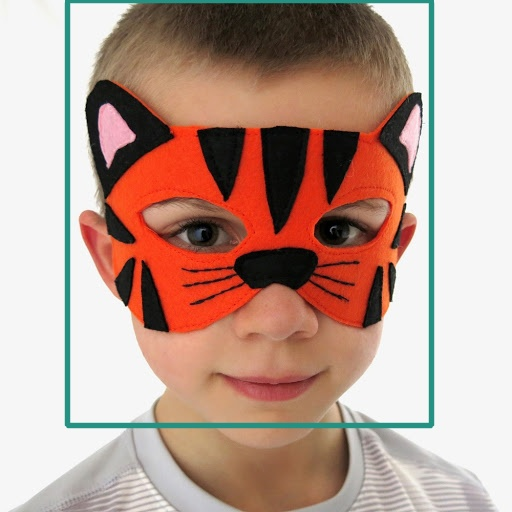

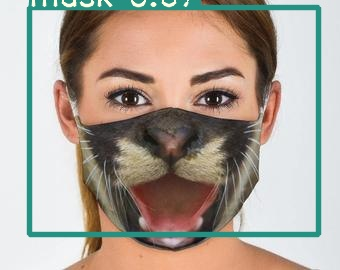

...

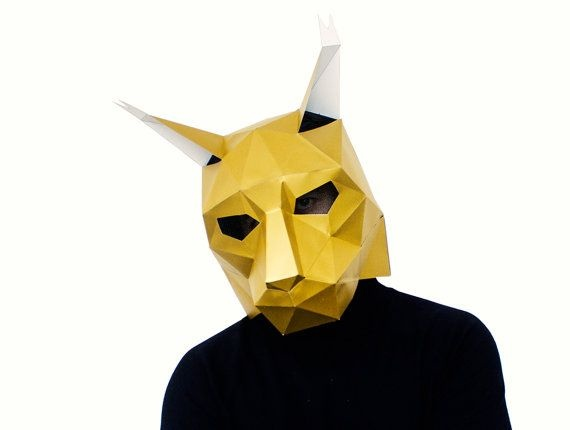

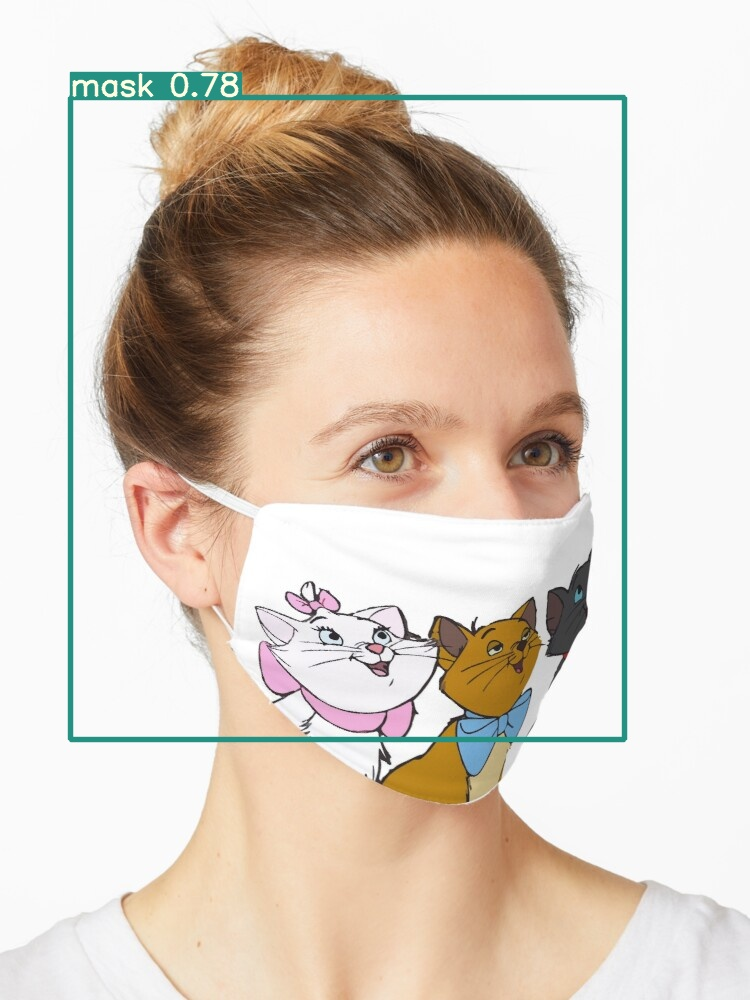

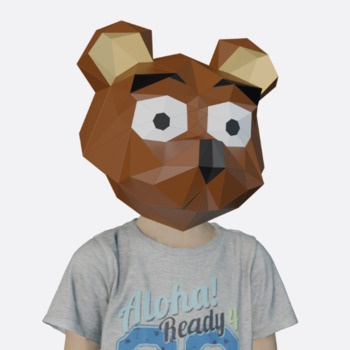

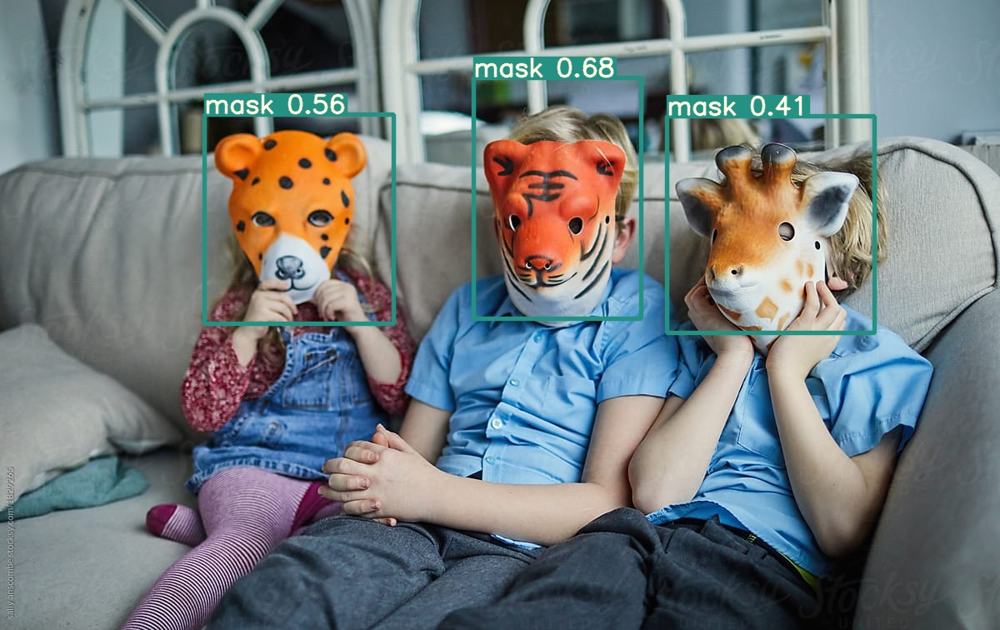

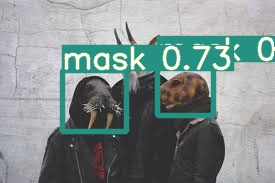

In [ ]:
#동물마스크
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp15/*.jpg'):
  display(Image(filename=imageName))
  print('\n')

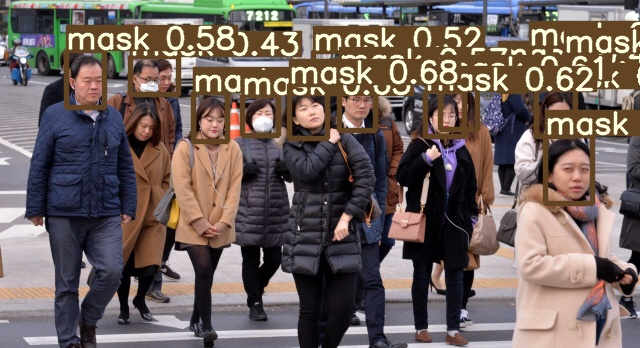

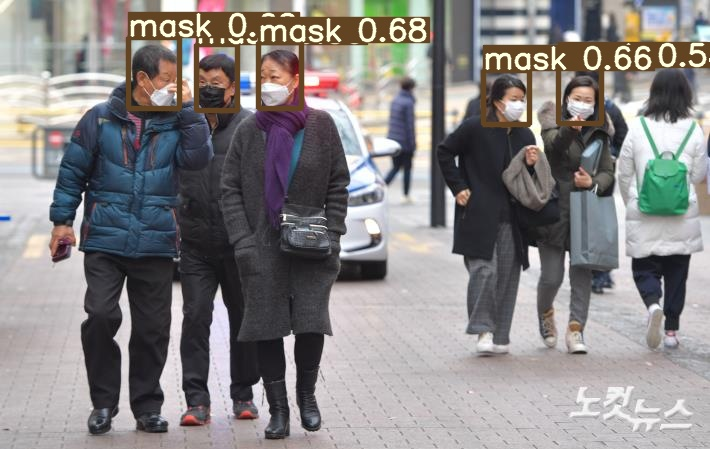

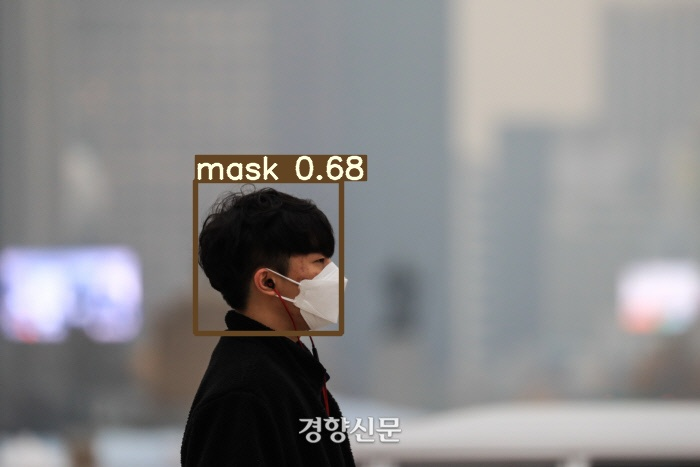

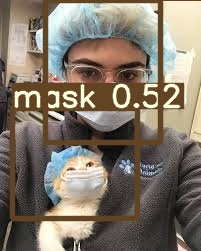

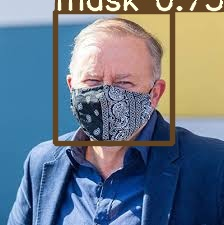

...

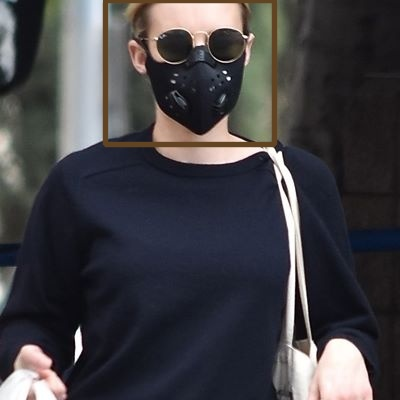

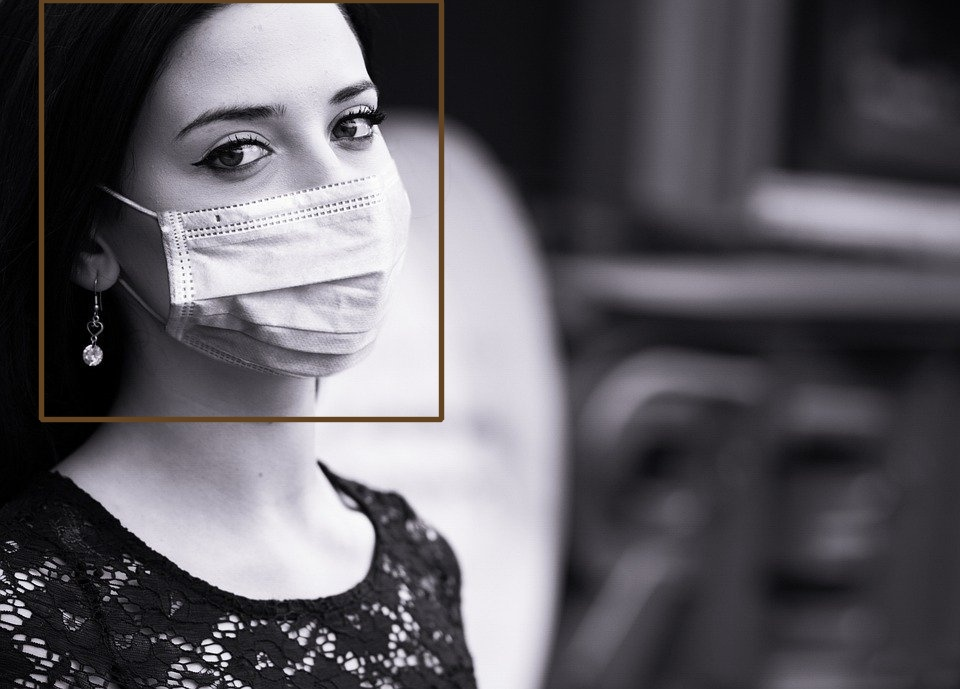

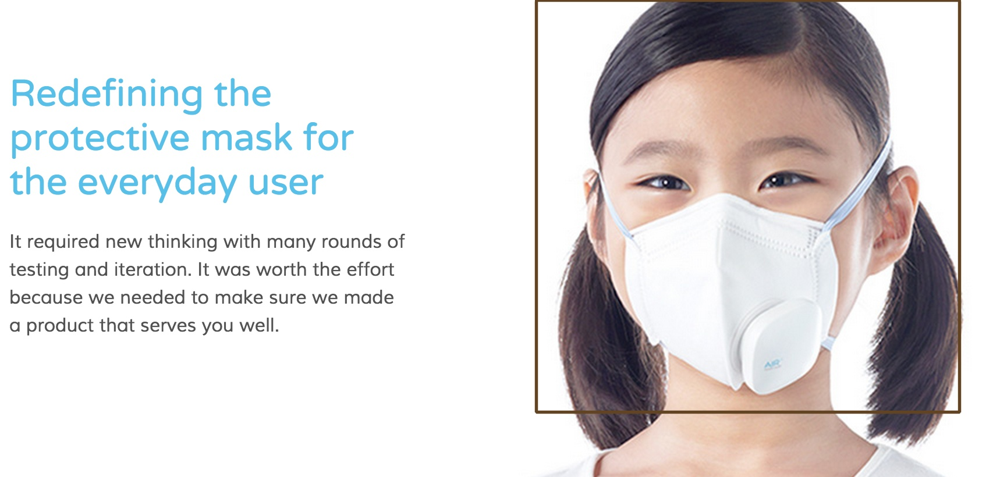

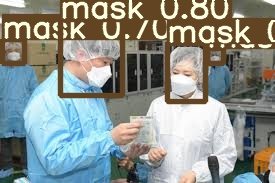

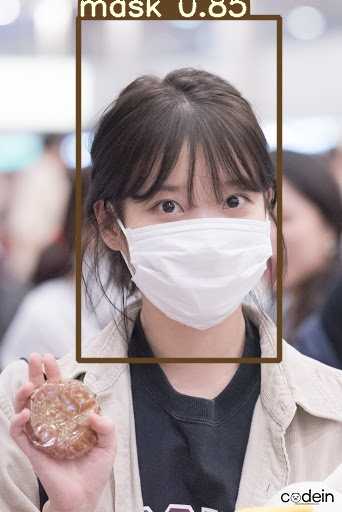

In [ ]:
#실사
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp11/*.jpg'):
  display(Image(filename=imageName))
  print('\n')